# Données géospatiales : dataviz avec plotly en mode BYOD 

1. **Introduction**
2. **Plotly**
3. **treemap et sunburst**
4. **Cartes choroplèthes**

Le lien : https://github.com/datacraft-paris/2206-Wolinski-GeospatialDataviz

## 1. En guise d'introduction

La richesse des librairies graphiques Python...

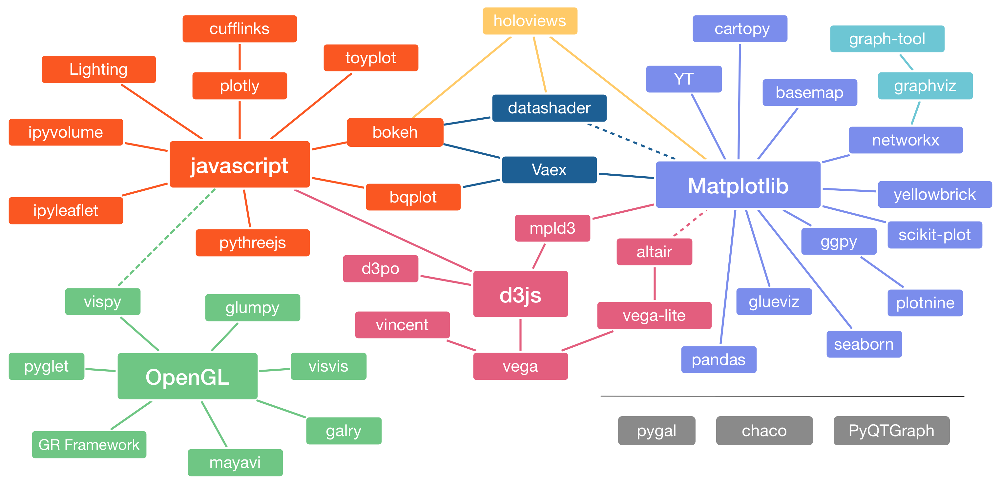

In [1]:
from IPython import display

# source Jake Vanderplas PyCon 2017
# voir https://sophiamyang.medium.com/python-visualization-landscape-3b95ede3d030

display.Image("./data/landscape-colors.png")

In [2]:
# https://pyviz.org

display.IFrame("https://pyviz.org/tools.html#geospatial", width=800, height=400)

Pour les cartographies :
- **basemap** : The matplotlib basemap toolkit is a library for plotting 2D data on maps in Python.
- **cartopy** : Cartopy is a Python package designed for geospatial data processing in order to produce maps and other geospatial data analyses.
- **ipleaflet** : Interactive maps in the Jupyter notebook
- **geopandas** : GeoPandas is an open source project to make working with geospatial data in python easier.
- **geoviews** : GeoViews is a Python library that makes it easy to explore and visualize any data that includes geographic locations. 
- **plotly** : Cf. ci-dessous...

## 2. Plotly pour des représentations interactives

Plotly est basé sur javascript. Il permet de créer des graphiques interactifs. Il est édité par la société canadienne *Plotly* et est également intégré dans le package **dash** de création de dashboards.

On va utiliser le module **plotly.express** dont l'API est particulièrement simple. Il existe un module plus complet : **plotly.graph_objects**.

In [3]:
# imports
import numpy as np
import pandas as pd
import plotly.express as px

## 3. treemap et sunburst

Une treemap (resp. sunburst) ou carte proportionnelle est une représentation rectangulaire (resp. circulaire) de données hiérarchiques dans un espace limité.

In [4]:
# dataset
fortune = (pd.read_csv("./data/Fortune_1000.csv", na_values="-")
           .fillna(0)
          )

fortune.head()

,company,rank,rank_change,revenue,profit,num. of employees,sector,city,state,newcomer,ceo_founder,ceo_woman,profitable,prev_rank,CEO,Website,Ticker,Market Cap
0,Walmart,1,0.0,523964.0,14881.0,2200000,Retailing,Bentonville,AR,no,no,no,yes,1.0,C. Douglas McMillon,https://www.stock.walmart.com,WMT,411690.0
1,Amazon,2,3.0,280522.0,11588.0,798000,Retailing,Seattle,WA,no,yes,no,yes,5.0,Jeffrey P. Bezos,https://www.amazon.com,AMZN,1637405.0
2,Exxon Mobil,3,-1.0,264938.0,14340.0,74900,Energy,Irving,TX,no,no,no,yes,2.0,Darren W. Woods,https://www.exxonmobil.com,XOM,177923.0
3,Apple,4,-1.0,260174.0,55256.0,137000,Technology,Cupertino,CA,no,no,no,yes,3.0,Timothy D. Cook,https://www.apple.com,AAPL,2221176.0
4,CVS Health,5,3.0,256776.0,6634.0,290000,Health Care,Woonsocket,RI,no,no,yes,yes,8.0,Karen S. Lynch,https://www.cvshealth.com,CVS,98496.0


In [5]:
# treemap
px.treemap(fortune,
          path=["sector", "company"],
          values="Market Cap")

In [6]:
# treemap
px.treemap(fortune,
          path=["state", "city"],
          values="num. of employees")

In [7]:
# on limite aux 4 première capitalisations par secteur
fortune2 = (fortune.groupby("sector")
            .apply(lambda g: g.nlargest(4, "Market Cap"))
           )

# sunburst
px.sunburst(fortune2,
          path=["sector", "company"],
          values="Market Cap")

## 4. Cartes choroplèthes

Une carte *choroplèthe* (du grec χῶρος  : « zone/région » et πλῆθος  : « grand nombre, multitude ») est une carte thématique où les régions sont colorées ou remplies d'un motif qui montre une mesure statistique.

Pour produire une carte choroplèthe, il faut récupérer un fichier *geojson* de la partie du monde considérée. Ce fichier contient entre autres 2 informations importantes :
- Une clé qui désigne chaque sous-région,
- La description d'un polygone ou d'un multi-polygones sous la forme d'une liste de coordonnées (latitudes et longitudes),

Il faut ensuite faire correspondre les valeurs de la colonne du DataFrame qui contient les données relatives à chaque sous-région avec celles de la clé du fichier *geojson*.

Il est possible ensuite d'utiliser différents fonds de cartes et différents nuanciers.

Le fichier "./data/departements.geojson" utilisé ci-après provient du site : https://france-geojson.gregoiredavid.fr/ et il faut analyser le fichier pour trouver la clé correspondant à chaque sous-région.

In [8]:
import json

with open("./data/departements.geojson") as f:
    departements = json.loads(f.read())

departements

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'geometry': {'type': 'Polygon',
    'coordinates': [[[3.172704445659, 50.011996744997],
      [3.1821975358417, 50.012335988197],
      [3.2174797791605, 50.023182479597],
      [3.230541907493, 50.031311385584],
      [3.2579143291896, 50.024436966985],
      [3.2581174425539, 50.031770179151],
      [3.2707157754254, 50.029466123914],
      [3.2801699122715, 50.015181662188],
      [3.2870975810209, 50.014184796787],
      [3.3105782894546, 50.019566104726],
      [3.3293480229819, 50.015985397797],
      [3.3371076812771, 50.017403207904],
      [3.3529876206925, 50.035860226771],
      [3.3748529135519, 50.03640787562],
      [3.3915828503565, 50.031901508452],
      [3.39890478116, 50.034755671377],
      [3.4135732928197, 50.027585361882],
      [3.447055807483, 50.022439728958],
      [3.491357082465, 50.018859654652],
      [3.5071388293519, 50.035778426858],
      [3.5286124821151, 50.038180178229],
      [3.53

Analyse du fichier geojson :
- departements["features"] est une liste de 96 dictionnaires (les différents départements avec '2A' et '2B')
- chaque dictionnaire contient les clés :
    - 'type': 'Feature'
    - 'geometry': informations géométriques (polygones...)
    - 'properties' : informations d'identification qui permettent de référencer chaque dictionnaire

In [9]:
# analyse du dictionnaire "departements"
departements["features"][0]["properties"]

{'code': '02', 'nom': 'Aisne'}

In [10]:
# liste des valeurs de la clé "code"
codes = sorted([f["properties"]["code"] for f in departements["features"]])
print(*codes)

01 02 03 04 05 06 07 08 09 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26 27 28 29 2A 2B 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95


In [11]:
# dataset 
geo = pd.read_csv("data/correspondance-code-insee-code-postal.csv",
                 sep=";",
                 )

geo.head()

,Code INSEE,Code Postal,Commune,Département,Région,Statut,Altitude Moyenne,Superficie,Population,geo_point_2d,geo_shape,ID Geogla,Code Commune,Code Canton,Code Arrondissement,Code Département,Code Région
0,31080,31350,BOULOGNE-SUR-GESSE,HAUTE-GARONNE,MIDI-PYRENEES,Chef-lieu canton,301.0,2470.0,1.6,"43.2904403081, 0.650641474176","{""type"": ""Polygon"", ""coordinates"": [[[0.671852...",5761,80,6,2,31,73
1,11143,11510,FEUILLA,AUDE,LANGUEDOC-ROUSSILLON,Commune simple,314.0,2426.0,0.1,"42.9291375888, 2.90138923544","{""type"": ""Polygon"", ""coordinates"": [[[2.906996...",3869,143,30,3,11,91
2,43028,43200,BESSAMOREL,HAUTE-LOIRE,AUVERGNE,Commune simple,888.0,743.0,0.4,"45.1306448726, 4.07952494849","{""type"": ""Polygon"", ""coordinates"": [[[4.091674...",5894,28,29,3,43,83
3,78506,78660,PRUNAY-EN-YVELINES,YVELINES,ILE-DE-FRANCE,Commune simple,155.0,2717.0,0.8,"48.5267627187, 1.80513972814","{""type"": ""Polygon"", ""coordinates"": [[[1.829610...",25381,506,19,2,78,11
4,84081,84310,MORIERES-LES-AVIGNON,VAUCLUSE,PROVENCE-ALPES-COTE D'AZUR,Commune simple,49.0,1042.0,7.6,"43.9337788848, 4.90875878315","{""type"": ""Polygon"", ""coordinates"": [[[4.927176...",29013,81,23,2,84,93


On voit que l'on va pouvoir utiliser la colonne "Code Département" pour référencer les dictionnaires du fichier *geojson*. La clé d'accès sera : "properties.code".

In [12]:
# liste des "Code Département"
codes2 = sorted(geo["Code Département"].unique())
print(*codes2)

01 02 03 04 05 06 07 08 09 10 11 12 13 14 15 16 17 18 19 21 22 23 24 25 26 27 28 29 2A 2B 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 97


On calcule le nombre d'habitants par département.

In [13]:
# population des départements
df = (geo.groupby("Code Département", as_index=False)["Population"]
      .sum()
     )

df.head()

,Code Département,Population
0,01,588.8
1,02,541.4
2,03,343.3
3,04,159.0
4,05,135.3


On produit la carte directement en donnant notamment les 4 informations :
- le dictionnaire issu du fichier *geojson* : `geojson=departements`,
- la clé dans le DataFrame : `locations='Code Département'`
- la clé dans le fichier *geojson* : `featureidkey='properties.code'`
- la grandeur représentée : `color='Population'`

In [19]:
# choropleth_mapbox
px.choropleth_mapbox(data_frame=df,
                     geojson=departements,
                     locations='Code Département',
                     color='Population',
                     featureidkey='properties.code',
                     color_continuous_scale="teal",
                     mapbox_style="carto-positron",
                     zoom=4.5,
                     center = {"lat": 47.0, "lon": 0.0},
                     opacity=0.5,
                     labels={'Population': 'Population en milliers'}
                    )

In [20]:
# population des départements
df = (geo.groupby("Code Département", as_index=False)["Altitude Moyenne"]
      .mean()
     )

df.head()

,Code Département,Altitude Moyenne
0,01,408.451074
1,02,123.291667
2,03,331.328125
3,04,964.120000
4,05,1329.932203


In [25]:
# choropleth_mapbox
px.choropleth_mapbox(data_frame=df,
                     geojson=departements,
                     locations='Code Département',
                     color='Altitude Moyenne',
                     featureidkey='properties.code',
                     color_continuous_scale="RdBu_r",
                     mapbox_style="carto-positron",
                     zoom=4.0,
                     
                     opacity=0.5,
                     labels={'Altitude Moyenne': 'Altitude Moyenne en mètres'}
                    )center = {"lat": 47.0, "lon": 0.0},

In [34]:
px.choropleth_mapbox?

<div class="alert alert-success">
    <h3><i class="fa fa-edit"></i>  Exercise 1</h3>
    <ul>
        <li>Produire la même carte choroplèthe en utilisant non pas le n° mais le nom du département. Que constate-t-on ?</li>
    </ul>
</div>

In [28]:
"ALPES-MARITIMES".title()

'Alpes-Maritimes'

In [30]:
df["Département"].str.title()

0                          Ain
1                        Aisne
2                       Allier
3      Alpes-De-Haute-Provence
4              Alpes-Maritimes
                ...           
96                      Vendee
97                      Vienne
98                      Vosges
99                       Yonne
100                   Yvelines
Name: Département, Length: 101, dtype: object

In [31]:
# population des départements method chaining
df = (geo.groupby("Département", as_index=False)["Population"]
      .sum()
      .assign(Département=lambda df_: df_["Département"].str.title())
     )

df.head()

,Département,Population
0,Ain,588.8
1,Aisne,541.4
2,Allier,343.3
3,Alpes-De-Haute-Provence,159.0
4,Alpes-Maritimes,1079.6


In [42]:
# population des départements
df = (geo.groupby("Département", as_index=False)["Population"]
      .sum()
     )

df["Département"] = df["Département"].str.title()

df.head()

,Département,Population
0,Ain,588.8
1,Aisne,541.4
2,Allier,343.3
3,Alpes-De-Haute-Provence,159.0
4,Alpes-Maritimes,1079.6


In [43]:
# choropleth_mapbox
px.choropleth_mapbox(data_frame=df,
                     geojson=departements,
                     locations='Département',
                     color='Population',
                     featureidkey='properties.nom',
                     color_continuous_scale="teal",
                     mapbox_style="white-bg",
                     zoom=4.5,
                     center = {"lat": 47.0, "lon": 0.0},
                     opacity=0.5,
                     labels={'Population': 'Population en milliers'}
                    )

In [ ]:
# %load exo_1.py

<div class="alert alert-success">
    <h3><i class="fa fa-edit"></i>  Exercise 2</h3>
    <ul>
        <li>Produire une carte choroplèthe avec la moyenne de l'Altitude Moyenne de chaque département, en utilisant le fond de carte "stamen-terrain" et le nuancier "reds".</li>
    </ul>
</div>

In [39]:
# population des départements
df = (geo.groupby("Code Département", as_index=False)["Altitude Moyenne"]
      .mean()
     )

df.head()

,Code Département,Altitude Moyenne
0,01,408.451074
1,02,123.291667
2,03,331.328125
3,04,964.120000
4,05,1329.932203


In [40]:
# choropleth_mapbox
px.choropleth_mapbox(data_frame=df,
                     geojson=departements,
                     locations='Code Département',
                     color='Altitude Moyenne',
                     featureidkey='properties.code',
                     color_continuous_scale="reds",
                     mapbox_style="stamen-terrain",
                     zoom=4.0,
                     center = {"lat": 47.0, "lon": 0.0},
                     opacity=0.5,
                     labels={'Altitude Moyenne': 'Altitude Moyenne en mètres'}
                    )

In [ ]:
# %load exo_2.py

<div class="alert alert-success">
    <h3><i class="fa fa-edit"></i>  Exercise 3 - pour ceux qui n'ont pas de dataset</h3>
    <ul>
        <li>Charger le fichier "./data/arrondissements.geojson" et analyser la clé d'accès aux arrondissements (source: https://github.com/fxjollois/donnees)</li>
        <li>Charger et préparer le fichier Airbnb "./data/airbnb.csv"</li>
        <li>Calculer le prix moyen des hébergements Airbnb par arrondissement parisien.</li>
        <li>Analyser les écarts entre les n° d'arrondissements avec la clé d'accès aux arrondissements dans le fichier <i>geojson</i> et opérer les transformations nécessaires.</li>
        <li>Produire une carte choroplèthe avec la moyenne du prix des hébergements Airbnb de chaque arrondissement parisien, en utilisant le fond de carte "open-street-map" et le nuancier "reds".</li>
    </ul>
</div>

In [ ]:
# "75001" => 1
# "75018" => 18

In [48]:
zipcode = "75001"
int(zipcode[3:5].lstrip("0"))

1

In [47]:
zipcode = "75018"
int(zipcode[3:5].lstrip("0"))

18

In [50]:
import json

with open("./data/arrondissements.geojson") as f:
    arrondissements = json.loads(f.read())

arrondissements

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'geometry': {'coordinates': [[[2.351518483670822, 48.8644258050741],
      [2.350949105218923, 48.86340592861751],
      [2.346676032763326, 48.864430925901665],
      [2.346675453051013, 48.864431064833674],
      [2.345101655171463, 48.864809197959836],
      [2.341271025930368, 48.86572767724483],
      [2.34126849090564, 48.86572828653818],
      [2.341204510696185, 48.865743681005995],
      [2.341178272058699, 48.86574963323162],
      [2.341083555178272, 48.86577201721946],
      [2.337371969067098, 48.86664907439457],
      [2.335869691238242, 48.866996475356],
      [2.335869054057415, 48.866996626507536],
      [2.333675321300196, 48.867516125009374],
      [2.33172601351949, 48.86795481659967],
      [2.33172562934836, 48.86795490259038],
      [2.33065673396009, 48.86819218066116],
      [2.330306795320875, 48.86835619167467],
      [2.329965588686571, 48.86851416917428],
      [2.328007329038849, 48.8699174

In [53]:
# liste des valeurs de la clé "code"
codes = sorted([f["properties"]["c_ar"] for f in arrondissements["features"]])
print(codes)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]


In [70]:
paris = (pd.read_csv("./data/airbnb.csv")
         .loc[lambda df_: df_["zipcode"].str.startswith("75", na=False)]
         .assign(arrondissement=lambda df_: df_["zipcode"].str[3:5].astype(int),
                price2=lambda df_: df_["price"].str.lstrip("$").str.replace(",", "").astype(float))
        )
paris.head()

,zipcode,price,arrondissement,price2
0,75006,$145.00,6,145.0
1,75011.0,$81.00,11,81.0
2,75006,$95.00,6,95.0
3,75020,$35.00,20,35.0
4,75020,$50.00,20,50.0


In [72]:
# population des départements
df = (paris.groupby("arrondissement", as_index=False)["price2"]
      .mean()
     )

df

,arrondissement,price2
0,1,140.080808
1,2,120.818792
2,3,134.375566
3,4,123.898810
4,5,102.918129
5,6,142.091603
6,7,159.314685
7,8,172.380531
8,9,100.913420
9,10,84.580737


In [74]:
# choropleth_mapbox
px.choropleth_mapbox(data_frame=df,
                     geojson=arrondissements,
                     locations='arrondissement',
                     color='price2',
                     featureidkey='properties.c_ar',
                     color_continuous_scale="reds",
                     mapbox_style="open-street-map",
                     zoom=11.0,
                     center = {"lat": 48.86, "lon": 2.35},
                     opacity=0.5,
                     labels={'Prix Moyen': 'Prix Moyen en dollars'}
                    )

In [ ]:
# %load exo_3.py

<div class="alert alert-info">
    <h3><i class="fa fa-info-circle"></i> Documentation</h3>
    <p><a href="https://plotly.com/python/plotly-express/">Plotly Express</a></p>
    <p><a href="https://plotly.com/python/builtin-colorscales/">Built-in Continuous Color Scales</a></p>
    <p><a href="https://plotly.com/python/mapbox-layers/">Mapbox Map Layers</a></p>
</div>